## Install Detectron2

In [1]:
!python -m pip install pyyaml==5.1
import sys, os, distutils.core
# Note: This is a faster way to install detectron2 in Colab, but it does not include all functionalities (e.g. compiled operators).
# See https://detectron2.readthedocs.io/tutorials/install.html for full installation instructions
!git clone 'https://github.com/facebookresearch/detectron2'
dist = distutils.core.run_setup("./detectron2/setup.py")
!python -m pip install {' '.join([f"'{x}'" for x in dist.install_requires])}
sys.path.insert(0, os.path.abspath('./detectron2'))

# Properly install detectron2. (Please do not install twice in both ways)
# !python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 274.2/274.2 kB 6.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for pyyaml: filename=PyYAML-5.1-cp310-cp310-linux_x86_64.whl size=44090 sha256=b46b694bf5ddbf096a29ad6605cb463cac9ab161b896bb020f897af137f0ee85
  Stored in directory: /root/.cache/pip/wheels/70/83/31/975b737609aba39a4099d471d5684141c1fdc3404f97e7f68a
Successfully built pyyaml
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 6.0
    Uninstalling PyYAML-6.0:
      Successfully uninstalled PyYAML-6.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
dask 2022.12.1 requires pyyaml>=5.3.1, but you have pyyaml 5.1 which is incompatible.
flax 0.6.9 requires PyYAML>=5.4.1, but you have pyyaml 5.1 which is incompatibl

In [2]:
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2022 NVIDIA Corporation
Built on Wed_Sep_21_10:33:58_PDT_2022
Cuda compilation tools, release 11.8, V11.8.89
Build cuda_11.8.r11.8/compiler.31833905_0
torch:  2.0 ; cuda:  cu118
detectron2: 0.6


In [3]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

In [8]:
cfg = get_cfg()
# add project-specific config (e.g., TensorMask) here if you're not running a model in detectron2's core library
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # set threshold for this model
# Find a model from detectron2's model zoo. You can use the https://dl.fbaipublicfiles... url as well
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
predictor = DefaultPredictor(cfg)
# outputs = predictor(im)

[06/16 06:57:13 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...


model_final_f10217.pkl: 178MB [00:01, 176MB/s]                           


# Train on a custom dataset

In [5]:
# #@title Downloading the dataset from original repo

# # Be warned this will take some time to download
# %cd TACO
# !dir
# !python3 download.py

# #@title Default title text
# %cd /content/TACO/detector
# !python3 split_dataset.py --dataset_dir /content/TACO/data --test_percentage 10 --val_percentage 15 --nr_trials 1

# %cd /content/TACO/data
# !dir

# from detectron2.data.datasets import register_coco_instances

# register_coco_instances("taco_train", {}, "/content/TACO/data/annotations_0_train.json", "/content/TACO/data/")
# register_coco_instances("taco_valid", {}, "/content/TACO/data/annotations_0_val.json", "/content/TACO/data/")
# register_coco_instances("taco_test", {}, "/content/TACO/data/annotations_0_test.json", "/content/TACO/data/")



# Using Roboflow -> Recommended

In [4]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="i9WRerscBGsGOqibsVrh")
project = rf.workspace("tom-rowland-03ams").project("taco-wikc7")
dataset = project.version(3).download("coco")

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 kB 2.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 8.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.8/67.8 kB 10.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 682.2/682.2 kB 24.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 8.5 MB/s eta 0:00:00
  Created wheel for wget: filename=wget-3.2-py3-none-any.whl size=9657 sha256=18a4bba30f4c92dc0f0440bde3e7175e16bbe8c3082d561d214531344454615a
  Stored in directory: /root/.cache/pip/wheels/8b/f1/7f/5c94f0a7a505ca1c81cd1d9208ae2064675d97582078e6c769
Successfully built wget
  Attempting uninstall: PyYAML
    Found existing installation: PyYAML 5.1
    Uninstalling PyYAML-5.1:
      Successfully uninstalled PyYAML-5.1
  Attempting uninstall: pyparsing
    

loading Roboflow workspace...
loading Roboflow project...

Extracting Dataset Version Zip to TACO-3 in coco:: 100%|██████████| 3590/3590 [00:04<00:00, 806.06it/s]


In [5]:
from detectron2.data.datasets import register_coco_instances

register_coco_instances("taco_train", {}, "/content/TACO-3/train/_annotations.coco.json", "/content/TACO-3/train")
register_coco_instances("taco_valid", {}, "/content/TACO-3/valid/_annotations.coco.json", "/content/TACO-3/valid")
register_coco_instances("taco_test", {}, "/content/TACO-3/test/_annotations.coco.json", "/content/TACO-3/test")


To verify the dataset is in correct format, let's visualize the annotations of randomly selected samples in the training set:



WARNING [06/16 06:56:52 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[06/16 06:56:52 d2.data.datasets.coco]: Loaded 3133 images in COCO format from /content/TACO-3/train/_annotations.coco.json


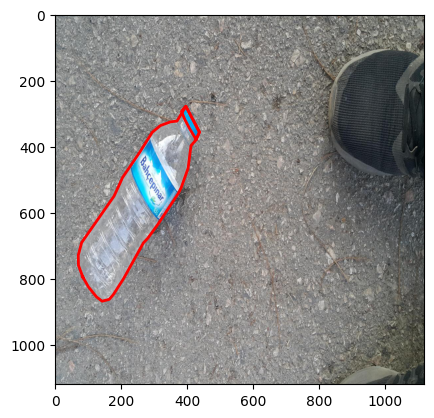

In [6]:
from matplotlib import pyplot as plt
from PIL import Image

dataset_train = DatasetCatalog.get("taco_train")
fig, ax = plt.subplots()
dataset_dict = random.choice(dataset_train)
im = Image.open(dataset_dict['file_name'])
ax.imshow(im)
for ann in dataset_dict['annotations']:
    for poly in ann['segmentation']:
        x = poly[0::2]
        y = poly[1::2]
        ax.plot(x,y, linewidth=2, color='red')

In [12]:
from detectron2.engine import DefaultTrainer

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("taco_train",)
cfg.DATASETS.TEST = ("taco_test",)
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025
cfg.SOLVER.MAX_ITER = 6000
cfg.SOLVER.STEPS = []
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 25


os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[06/16 07:07:01 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}


[06/16 07:07:02 d2.engine.train_loop]: Starting training from iteration 0
[06/16 07:07:11 d2.utils.events]:  eta: 0:34:29  iter: 19  total_loss: 4.877  loss_cls: 3.204  loss_box_reg: 0.6461  loss_mask: 0.6932  loss_rpn_cls: 0.2389  loss_rpn_loc: 0.03357    time: 0.3617  last_time: 0.3390  data_time: 0.0260  last_data_time: 0.0167   lr: 4.9953e-06  max_mem: 2114M
[06/16 07:07:24 d2.utils.events]:  eta: 0:35:53  iter: 39  total_loss: 4.501  loss_cls: 3.055  loss_box_reg: 0.6298  loss_mask: 0.6921  loss_rpn_cls: 0.03787  loss_rpn_loc: 0.01254    time: 0.4275  last_time: 0.3573  data_time: 0.0114  last_data_time: 0.0056   lr: 9.9902e-06  max_mem: 2114M
[06/16 07:07:31 d2.utils.events]:  eta: 0:35:27  iter: 59  total_loss: 4.217  loss_cls: 2.725  loss_box_reg: 0.4904  loss_mask: 0.692  loss_rpn_cls: 0.07841  loss_rpn_loc: 0.01545    time: 0.3972  last_time: 0.3720  data_time: 0.0100  last_data_time: 0.0055   lr: 1.4985e-05  max_mem: 2116M
[06/16 07:07:38 d2.utils.events]:  eta: 0:35:20  ite

In [10]:
# save model
torch.save(trainer.model.state_dict(), '/content/model_weights.pth')

# download the model weights to local system
from google.colab import files
files.download('/content/model_weights.pth')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [11]:
from google.colab import drive
drive.mount('/content/drive')

MessageError: ignored

In [12]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

In [13]:
from detectron2.data.detection_utils import read_image

# Inference should use the config with parameters that are used in training
# cfg now already contains everything we've set previously. We changed it a little bit for inference:

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model just trained
# cfg.MODEL.WEIGHTS="/content/model_weights.pth"
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set a threshold
predictor = DefaultPredictor(cfg)

[06/16 07:42:48 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


In [ ]:
# import cv2
# from detectron2.utils.visualizer import ColorMode
# dataset_dicts = DatasetCatalog.get("taco_valid")
# for d in random.sample(dataset_dicts, 15):
# # for d in dataset_dicts:
#     im = cv2.imread(d["file_name"])
#     outputs = predictor(im)
#     # v = Visualizer(im[:, :, ::-1],
#     #               metadata=MetadataCatalog.get("taco_valid"),
#     #               scale=0.5,
#     #               instance_mode=ColorMode.SEGMENTATION
#     # )
#     # out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
#     # im = Image.fromarray(out.get_image()[:, :, ::-1])
#     # plt.figure(figsize=(20, 20))
#     # plt.imshow(im)
#     # plt.show()

WARNING [06/16 07:45:22 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[06/16 07:45:22 d2.data.datasets.coco]: Loaded 200 images in COCO format from /content/TACO-3/test/_annotations.coco.json


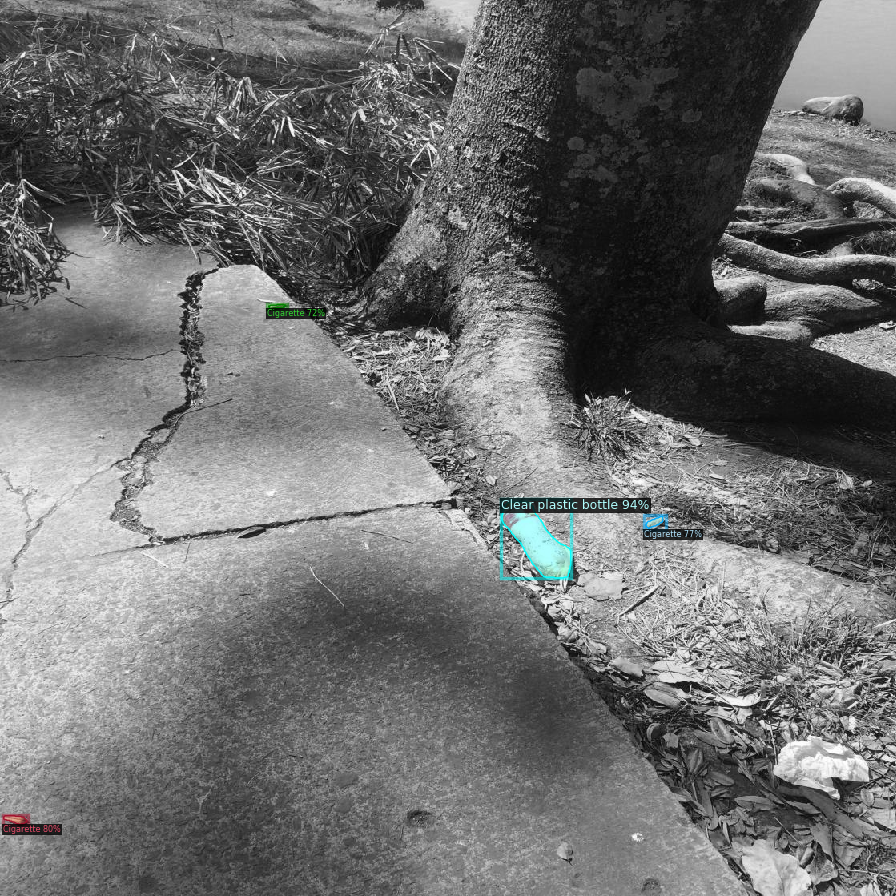

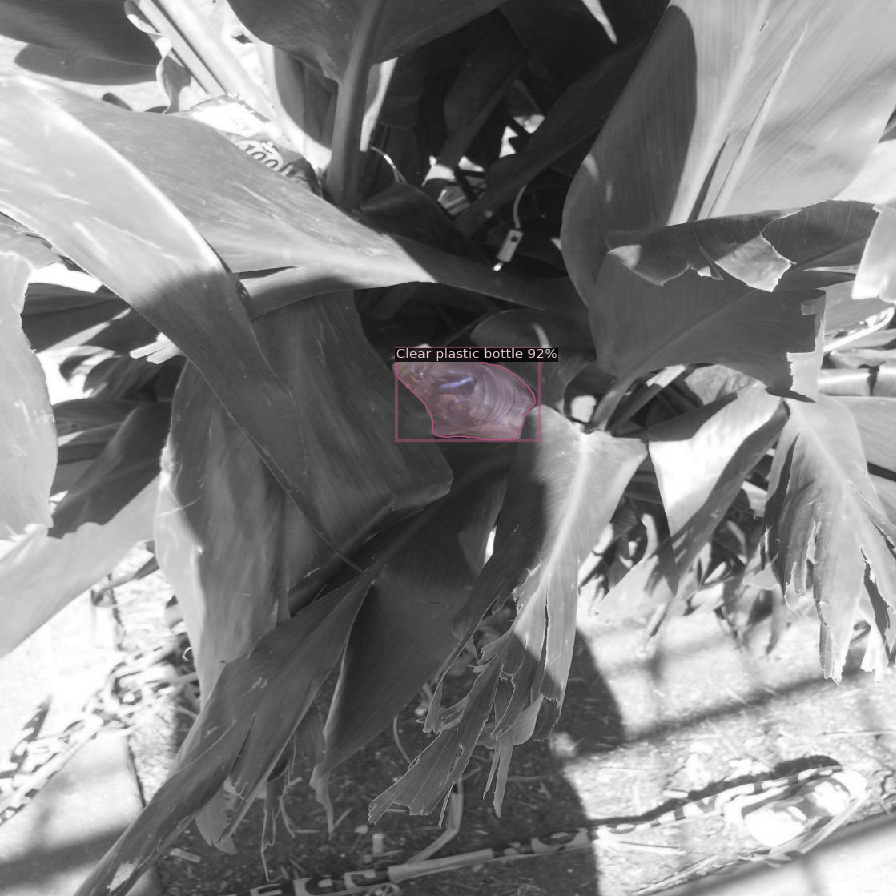

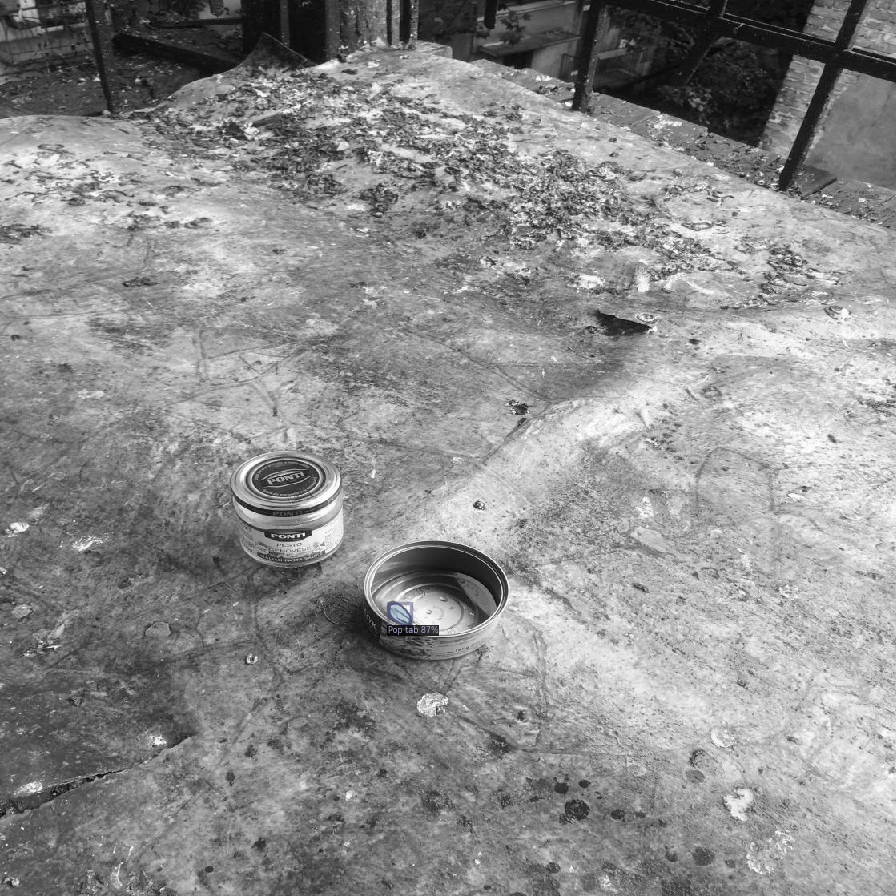

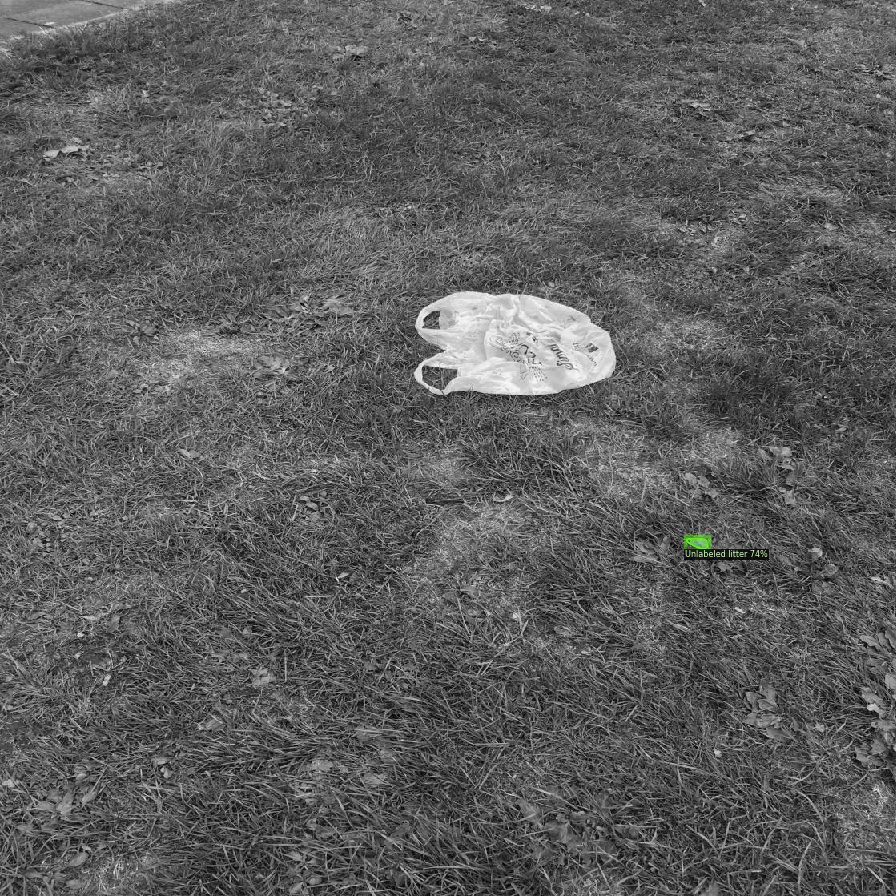

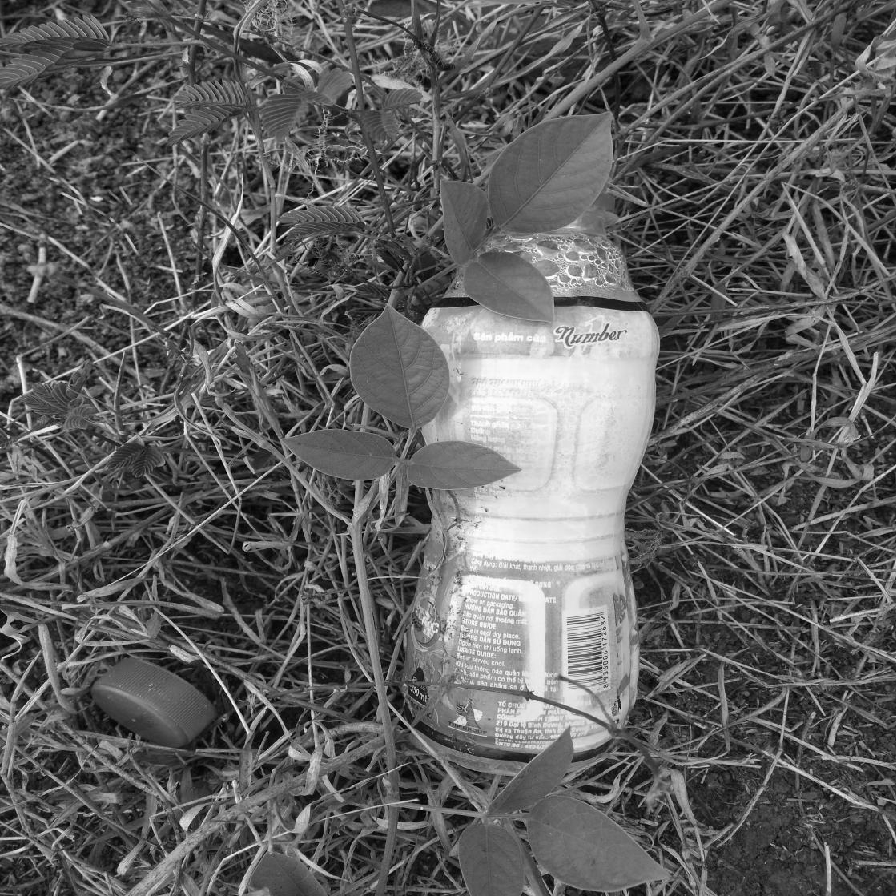

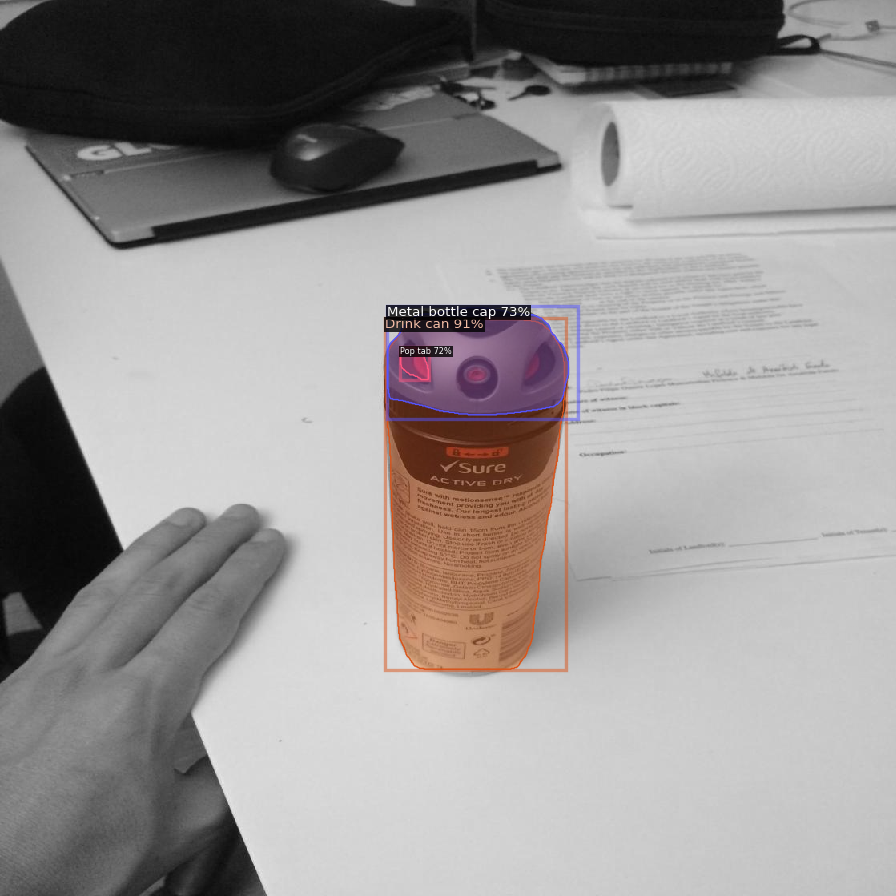

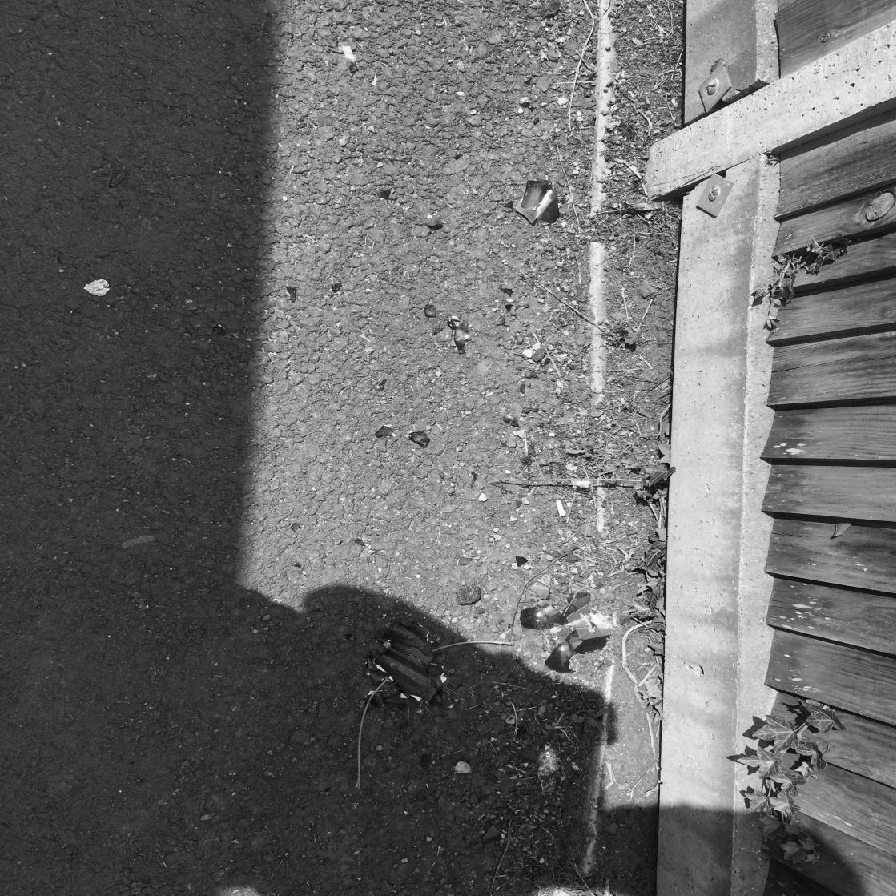

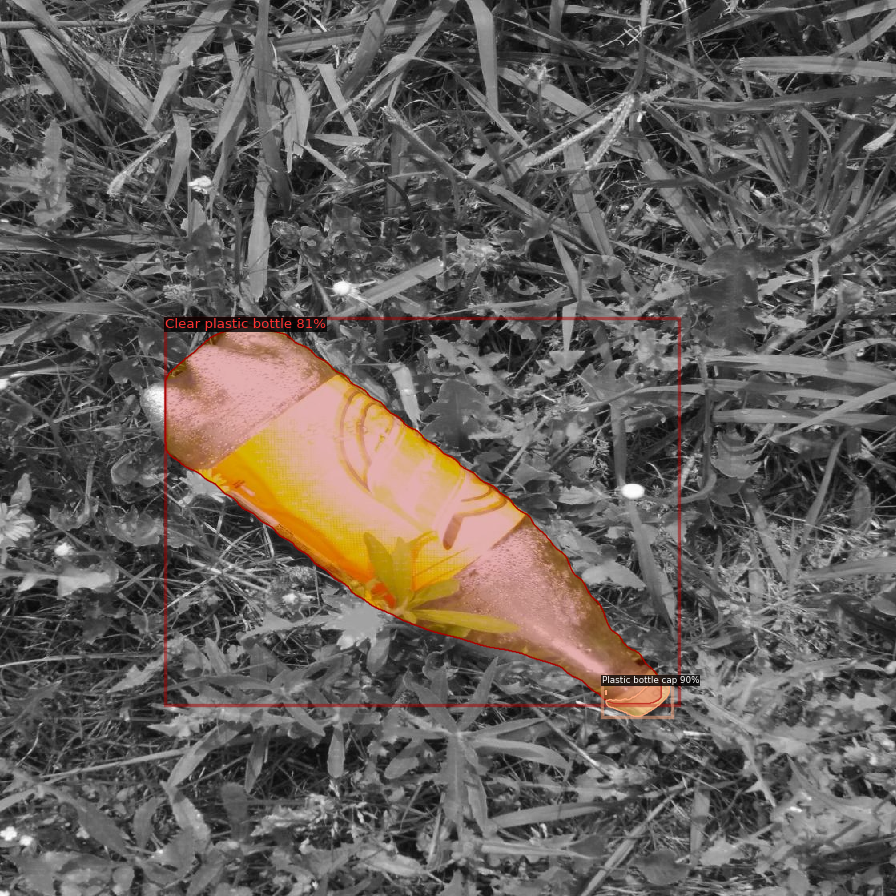

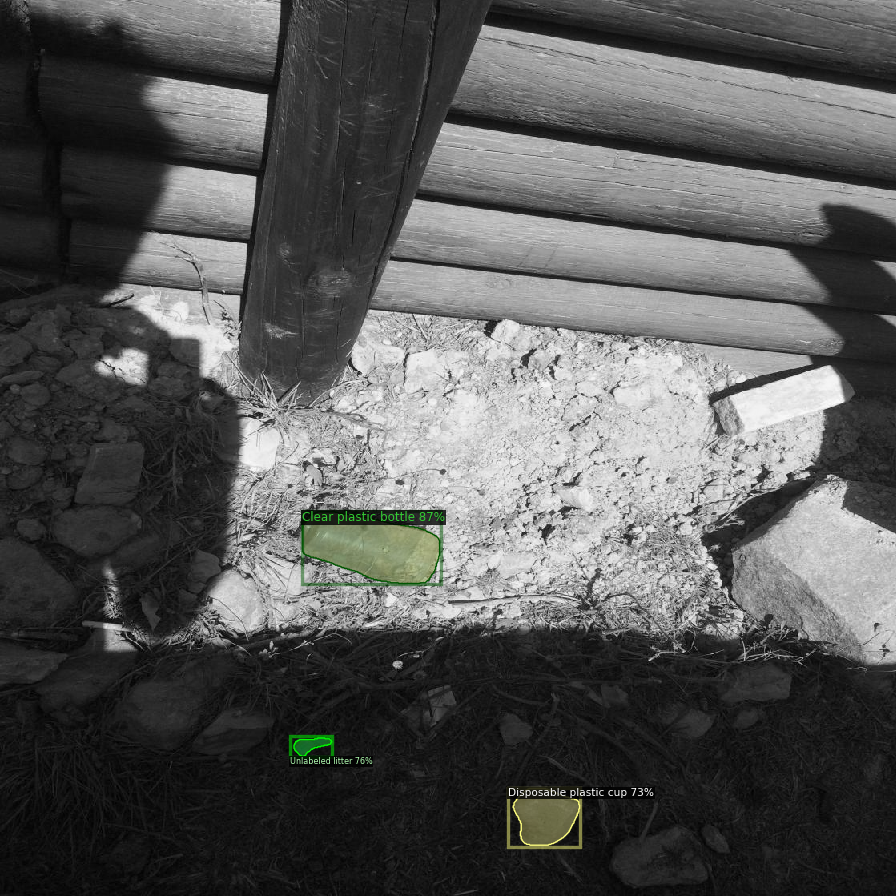

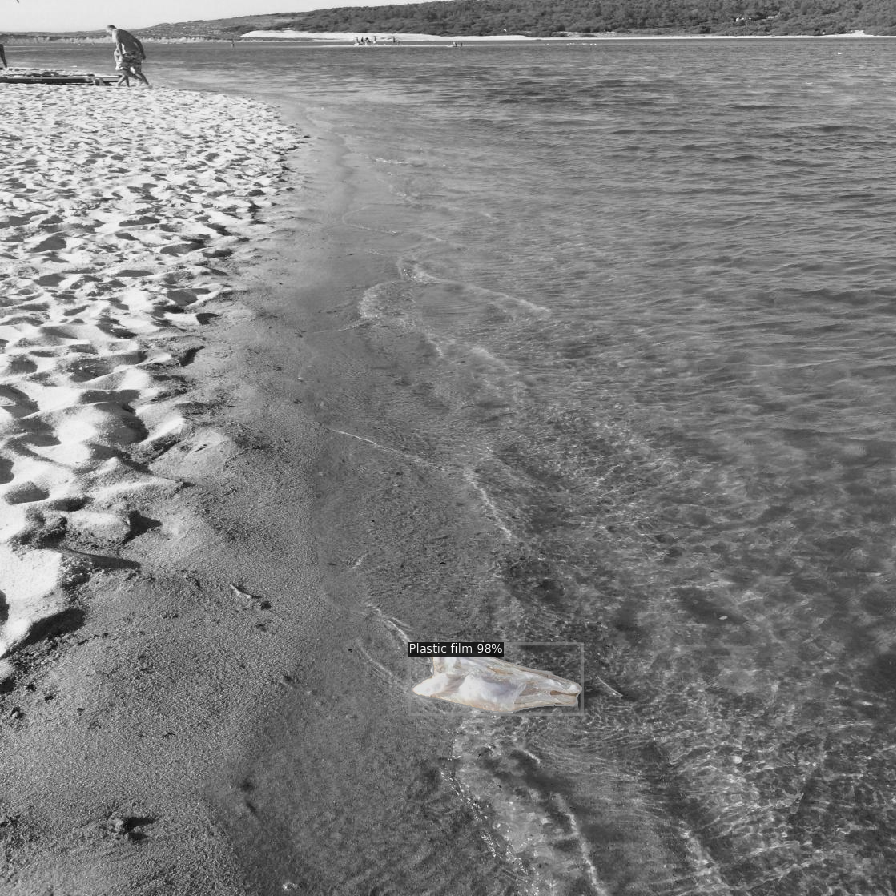

In [19]:

import cv2
from detectron2.utils.visualizer import ColorMode
dataset_dicts = DatasetCatalog.get("taco_test")
for d in random.sample(dataset_dicts, 10):
    img = cv2.imread(d["file_name"])
    outputs = predictor(img)

    visualizer = Visualizer(
        img[:, :, ::-1],
        metadata=MetadataCatalog.get("taco_test"),
        scale=0.8,
        instance_mode=ColorMode.IMAGE_BW
    )
    out = visualizer.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])

In [ ]:
import cv2
from detectron2.utils.visualizer import ColorMode
dataset_dicts = DatasetCatalog.get("taco_valid")
for d in random.sample(dataset_dicts, 40):
    img = cv2.imread(d["file_name"])
    outputs = predictor(img)

    visualizer = Visualizer(
        img[:, :, ::-1],
        metadata=MetadataCatalog.get("taco_valid"),
        scale=0.8,
        instance_mode=ColorMode.IMAGE_BW
    )
    out = visualizer.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])

In [25]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("taco_valid", output_dir="./output")
val_loader = build_detection_test_loader(cfg, "taco_valid")
print(inference_on_dataset(predictor.model, val_loader, evaluator))
# another equivalent way to evaluate the model is to use `trainer.test`

[06/15 15:36:51 d2.evaluation.coco_evaluation]: Fast COCO eval is not built. Falling back to official COCO eval.
WARNING [06/15 15:36:51 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[06/15 15:36:51 d2.data.datasets.coco]: Loaded 249 images in COCO format from /content/TACO-3/valid/_annotations.coco.json
[06/15 15:36:51 d2.data.build]: Distribution of instances among all 25 categories:
|   category    | #instances   |   category    | #instances   |   category    | #instances   |
|:-------------:|:-------------|:-------------:|:-------------|:-------------:|:-------------|
|    Litter     | 0            | Aluminium f.. | 12           | Broken glass  | 7            |
|   Cigarette   | 107          | Clear plast.. | 46           | Corrugated .. | 10           |
| Crisp packet  | 5            | Disposable .. | 20           |   Drink can   | 54           |
| Glass bottle  | 13           | Metal bottl.. | 12           | Norm

In [26]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("taco_test", output_dir="./output")
val_loader = build_detection_test_loader(cfg, "taco_test")
print(inference_on_dataset(predictor.model, val_loader, evaluator))
# another equivalent way to evaluate the model is to use `trainer.test`

[06/15 15:38:12 d2.evaluation.coco_evaluation]: Fast COCO eval is not built. Falling back to official COCO eval.
WARNING [06/15 15:38:12 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[06/15 15:38:12 d2.data.datasets.coco]: Loaded 200 images in COCO format from /content/TACO-3/test/_annotations.coco.json
[06/15 15:38:12 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[06/15 15:38:12 d2.data.common]: Serializing the dataset using: <class 'detectron2.data.common._TorchSerializedList'>
[06/15 15:38:12 d2.data.common]: Serializing 200 elements to byte tensors and concatenating them all ...
[06/15 15:38:12 d2.data.common]: Serialized dataset takes 0.27 MiB
[06/15 15:38:12 d2.evaluation.evaluator]: Start inference on 200 batches
[06/15 15:38:13 d2.evaluation.evaluator]: Inference done 11/200. Dataloading: 0.0055 